In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

import os
import re
import math
import subprocess
import numpy as np
import pandas as pd
import networkx as nx
from collections import defaultdict
from interval import interval

from IPython.display import display
import matplotlib.pyplot as plt
import matplotlib.image as img
from matplotlib_venn import venn2, venn3
plt.style.use('ggplot')
import plotly.offline as py
py.init_notebook_mode()
import plotly.figure_factory as ff
import plotly.graph_objs as go

In [2]:
## all datasets
datander_dbdump = "datander_dbdump"   # datander intervals for all reads
datander_ladump = "datander_ladump"   # datander alignments for all reads
trf_all_outfile = "reads_all.1.1.2.80.10.200.2000.dat"   # TRF result against all reads
mtr_outfile = "mtr_out"   # mTR results against all reads

## outputs (TR intervals and unit length) by each method
datander_result_fname = "datander_result"
trf_result_fname = "trf_result"
mtr_result_fname = "mtr_result"

In [3]:
## convertors between DB ids and fasta headers
dbid_header = pd.read_csv("dbid_header", sep="\t", header=None)
dbid_to_header = dict(zip(map(str, list(dbid_header.iloc[:, 0])), list(dbid_header.iloc[:,1])))
header_to_dbid = {v:k for k, v in dbid_to_header.items()}

In [4]:
max_dbid = 418271   # for using subset (Be careful it is *int* type)
#max_dbid = max(dbid_header.loc[:, 0])   # for using all the data. XXX: this is too heavy (~1.5M dbid)!

In [5]:
header_to_dbid["L401/102208/8217_29520 RQ=0.828"]

'418271'

In [72]:
## universal utilities

def interval_len(intvls):
    ret = 0
    for intvl in intvls.components:
        ret += intvl[0][1] - intvl[0][0] + 1
    return ret

# subtraction of integer intervals: A - B, and afterwards remove intervals whose length is less than <length threshold>
def subtract_interval(a_interval, b_interval, length_threshold=0):
    ret_interval = interval()
    intersection = a_interval & b_interval
    a_index = 0
    i_index = 0
    flag_load_new_interval = True   # use when there might be other intersecting intervals in an A-interval
    while a_index < len(a_interval) and i_index < len(intersection):
        if flag_load_new_interval:
            a_intvl = a_interval[a_index]
        else:
            flag_load_new_interval = False
        #print(a_index, i_index)
        #print(a_intvl, intersection[i_index])
        
        if a_intvl[1] < intersection[i_index][0]:
            ret_interval |= interval(a_intvl)
            a_index += 1
        elif a_intvl[0] > intersection[i_index][1]:
            i_index += 1
        else:
            a_start, a_end = a_intvl
            i_start, i_end = intersection[i_index]
            start_contained = True if min(a_start, i_start) == i_start else False
            end_contained = True if max(a_end, i_end) == i_end else False
            #print(start_contained, end_contained)
            if start_contained:
                if end_contained:
                    a_index += 1
                    i_index += 1
                else:
                    a_intvl = interval[i_end + 1, a_end]   # the tail interval that did not intersect with this B-interval (but maybe with the next B-interval)
                    flag_load_new_interval = False
                    i_index += 1
            else:
                if end_contained:
                    ret_interval |= interval[a_start, i_start - 1]
                    a_index += 1
                else:
                    ret_interval |= interval[a_start, i_start - 1]
                    a_intvl = interval[i_end + 1, a_end]
                    flag_load_new_interval = False
                    i_index += 1
    if not flag_load_new_interval:   # add a tail interval if it exists
        ret_interval |= interval(a_intvl)
        a_index += 1
    while a_index < len(a_interval):   # add remaining intervals in A
        ret_interval |= interval(a_interval[a_index])
        a_index += 1
    ret_interval_long = interval()   # length threshold
    for intvl in ret_interval.components:
        if interval_len(intvl) >= length_threshold:
            ret_interval_long |= intvl
    return ret_interval_long

# for adding an element (i.e. a row) into a dictionary that will be in the end converted to pd.DataFrame
def add_element(dic, columns, counter, data):
    for i in range(len(columns)):
        dic[columns[i]][counter] = data[i]

### Load data

In [7]:
## load self-vs-self alignments by datander

datander_alignments = defaultdict(dict)
datander_alignments_columns = ("dbid", "abpos", "aepos", "bbpos", "bepos")
counter = 0
with open(datander_ladump, 'r') as f:
    for line in f:
        data = line.strip().split(' ')
        if data[0] == "P":
            dbid = data[1]
            if int(dbid) > max_dbid:   # for using subset
                break
        elif data[0] == "C":
            add_element(datander_alignments, datander_alignments_columns, counter, [dbid] + list(map(int, data[1:5])))
            counter += 1
            
datander_alignments = pd.DataFrame.from_dict(datander_alignments)
datander_alignments = datander_alignments.loc[:, datander_alignments_columns]

In [8]:
## load TR intervals determined by TANmask

datander_intervals = defaultdict(dict)
datander_intervals_columns = ("dbid", "start", "end")
counter = 0
with open(datander_dbdump, 'r') as f:
    for line in f:
        data = line.strip().split(' ')
        if data[0] == "R":
            dbid = data[1]
            if int(dbid) > max_dbid:   # for using subset
                break
        elif data[0] == "T0" and int(data[1]) > 0:
            for i in range(int(data[1])):
                add_element(datander_intervals, datander_intervals_columns, counter, [dbid, int(data[1 + 2 * (i + 1)]), int(data[1 + 2 * (i + 1) + 1])])
                counter += 1
                
datander_intervals = pd.DataFrame.from_dict(datander_intervals)
datander_intervals = datander_intervals.loc[:, datander_intervals_columns]

### Algorithm v2.1

In [157]:
datander_results = defaultdict(dict)
datander_results_columns = ("dbid", "header", "start", "end", "unit length")
df_counter = 0

for dbid, alignments in datander_alignments.groupby("dbid"):
    if len(datander_intervals[datander_intervals["dbid"] == dbid]) == 0:   # no TR intervals
        continue
    uncovered_intervals = interval()
    for intvl in list(datander_intervals[datander_intervals["dbid"] == dbid].apply(lambda x: (x["start"], x["end"]), axis = 1)):
        uncovered_intervals |= interval[intvl]
    
    alignments = alignments.assign(distance = lambda x: x["abpos"] - x["bbpos"]).sort_values(by = "abpos", kind = "mergesort").sort_values(by = "distance", kind = "mergesort")
    #display(alignments)
    
    #print(header)
    #print(uncovered_intervals)
    
    # collect TR alignments that can cover the TR intervals
    cover_set = []
    for alignment in alignments.iterrows():
        ab, ae, bb, be = alignment[1][1:5]
        if not (0.95 <= float(ae - ab) / (be - bb) <= 1.05):   # abnormal slope, mainly due to skipping over deletion
            continue
        if not (ab - be <= 20):   # admit only TR alignments
            continue

        intersect = interval[bb, ae] & uncovered_intervals
        short_intervals = interval()
        for intvl in intersect.components:
            if interval_len(intvl) <= 20:
                short_intervals |= intvl
        intersect = subtract_interval(intersect, short_intervals, length_threshold=0)

        flag_deletion = False
        if len(intersect) == 1 and ((bb == intersect[0][0]) != (ae == intersect[-1][1])):
            flag_deletion = True

        if (not flag_deletion and intersect != interval()) or (interval_len(intersect) >= 1.5 * (ab - bb)): 
            cover_set.append((bb, ae, ab, be))    # NOTE: be careful with the order!
            uncovered_intervals = subtract_interval(uncovered_intervals, interval[bb, ae], length_threshold=500)
            if uncovered_intervals == interval():
                break
            #print("add:", interval[bb, ae])
            #print(uncovered_intervals)
    cover_set = sorted(cover_set)
    #print(cover_set)
    
    # determine minimum alignment cover set
    # contained TR alignmetns are also removed here (TODO: is it really desirable?)
    flanking_length = 100   # for suppressing fluctuation due to the sequencing error
    min_cover_set = []
    index = 0
    furthest_point = 0
    while index < len(cover_set):
        next_index = -1
        next_furthest = furthest_point
        skip_index = -1
        for i in range(index, len(cover_set)):
            bb, ae, ab, be = cover_set[i]
            if furthest_point < bb:
                skip_index = i
                skip_furthest = bb
                break
            else:
                if next_furthest + flanking_length < ae:
                    next_index = i
                    next_furthest = ae
        if next_index == -1:
            if skip_index == -1:
                break
            index = skip_index
            furthest_point = skip_furthest
        else:
            min_cover_set.append(cover_set[next_index])
            index = next_index + 1
            furthest_point = next_furthest
    #print(min_cover_set)
    
    # calculate unit length from each TR alignment itself in the minimum cover set
    for pos in min_cover_set:
        bb, ae, ab, be = pos
        add_element(datander_results, datander_results_columns, df_counter, (int(dbid), dbid_to_header[dbid], bb, ae, ab - bb))
        df_counter += 1
    
datander_results = pd.DataFrame.from_dict(datander_results)
datander_results = datander_results.loc[:, datander_results_columns]
datander_results = datander_results.sort_values(by="dbid").reset_index(drop=True)

In [158]:
datander_results.head()

,dbid,header,start,end,unit length
0,20,L416/2699/0_6897 RQ=0.826,0,6897,2
1,22,L416/2952/0_2430 RQ=0.784,1796,2430,40
2,22,L416/2952/0_2430 RQ=0.784,907,1461,21
3,22,L416/2952/0_2430 RQ=0.784,0,719,181
4,24,L416/3081/0_18265 RQ=0.861,0,18265,5221


In [159]:
datander_results.to_csv(datander_result_fname, sep="\t")

### Results of other methods

In [11]:
## TRF

# From the nearly-same interval, select only one best TR unit
def cluster_results(seq_name, res):
    ret = []
    
    G = nx.Graph()
    for i in range(len(res)):   # Calculate connected components. Not optimal in terms of time coplexity, but not so much time consuming.
        for j in range(i, len(res)):
            a_intvl = res[i][0]
            b_intvl = res[j][0]
            shorter_len = min(a_intvl[0][1] - a_intvl[0][0], b_intvl[0][1] - b_intvl[0][0])
            ovlp = a_intvl & b_intvl
            if len(ovlp) == 0:
                continue
            if ovlp[0][1] - ovlp[0][0] >= shorter_len / 2:   # Criteria for "connected" compnent: overlapping length >= 0.5 * shorter TR interval length
                G.add_edge(i, j)
    for cc in nx.connected_components(G):   # For each connected component, choose the best TR unit
        opt_index = -1
        min_len = 10000
        max_score = 0
        for i in cc:
            intvl, unit_len, score, unit_seq = res[i]
            if (score > max_score) or (score == max_score and unit_len < min_len):   # Criteria for "best" unit: max score -> min unit length
                opt_index = i
                max_score = score
                min_len = unit_len
        intvl, unit_len, score, unit_seq = res[opt_index]
        ret.append((int(header_to_dbid[seq_name]), seq_name, int(intvl[0][0]), int(intvl[0][1]), unit_len, unit_seq))
        
    return ret


trf_out = defaultdict(dict)
trf_columns = ("dbid", "header", "start", "end", "unit length", "unit sequence")
counter = 0
with open(trf_all_outfile, 'r') as f:
    flag_first = 0
    results = []
    for line in f:
        line = line.strip()
        if line == "" or re.match(r'^Parameters: ', line):
            continue
        elif re.match(r'Sequence: ', line):
            if flag_first == 0:
                seq_name = re.match(r'Sequence: (.*)', line).groups()[0]
                flag_first = 1
                continue
                
            if len(results) > 0:
                elems = cluster_results(seq_name, results)   # Second, select the best TR unit for each connected component of TR intervals
                for elem in elems:
                    add_element(trf_out, trf_columns, counter, elem)
                    counter += 1
                    
            if int(header_to_dbid[seq_name]) > max_dbid:   # for using subset. NOTE: reads in the input file must be sorted by dbid!
                break

            seq_name = re.match(r'Sequence: (.*)', line).groups()[0]
            results = []
        else:
            data = line.split(' ')
            if int(data[5]) < 65:   # filter out when percent_match is less than 65%
                continue
                
            intvl = interval([int(data[0]), int(data[1])])
            unit_len = int(data[4])
            score = int(data[7])
            unit_seq = data[13]

            results.append((intvl, unit_len, score, unit_seq))   # First, gather all TR intervals detected

    if len(results) > 0 and seq_name != max_header:
        elems = cluster_results(seq_name, results)
        for elem in elems:
            add_element(trf_out, trf_columns, counter, elem)
            counter += 1

trf_results = pd.DataFrame.from_dict(trf_out)
trf_results = trf_results.loc[:, trf_columns]   # align columns
trf_results = trf_results.dropna()   # remove NaN rows (i.e. not having TR intervals)

In [12]:
trf_results.head()

,dbid,header,start,end,unit length,unit sequence
0,20,L416/2699/0_6897 RQ=0.826,5,6897,13,AAGAGAGAAAGAG
1,53,L416/4303/0_23522 RQ=0.866,1,20823,10,AGAATAACAT
2,56,L416/4431/0_16117 RQ=0.872,6453,7017,182,ATTGTCGCCTATCATATTAATTAATATAAAGAATTTTATAAAGAGT...
3,56,L416/4431/0_16117 RQ=0.872,8171,11043,247,TACTATAGGTAGGCAGTGGTTGCCGGACCTCTCATATTGTTCAAAA...
4,58,L416/4484/0_22158 RQ=0.874,4374,4986,187,TCAAGAGTAGCCAAACACCTCGTCATCAATTTAGTGACGCATATGA...


In [13]:
#trf_results.to_csv(trf_result_fname, sep="\t")

In [14]:
## mTR

mtr_data = pd.read_csv(mtr_outfile, sep="\t", header=None).iloc[:, :17]
mtr_data.columns = ("repID", "ID", "readID", "read length", "start", "end", "len(act)", "unit len(est)", "unit len(act)", "# units", "matches", "mismatches", "ins", "del", "kmer", "method", "unit string")
mtr_data["dbid"] = mtr_data.apply(lambda x: int(header_to_dbid[x["readID"]]), axis = 1)
mtr_data = mtr_data[["dbid", "readID", "start", "end", "unit len(act)", "unit string", "# units", "len(act)"]]
mtr_data.columns = ("dbid", "header", "start", "end", "unit length", "unit sequence", "# units", "TR length")
mtr_results = mtr_data.sort_values(by="dbid").reset_index(drop=True)
mtr_results = mtr_results[mtr_results["dbid"] < max_dbid]

In [15]:
mtr_results.head()

,dbid,header,start,end,unit length,unit sequence,# units,TR length
0,39,L416/3707/0_2861 RQ=0.861,2241,2315,7,AATATAA,11,74
1,84,L416/5614/177_6289 RQ=0.824,1,6098,10,TGTTATTCTA,638,6096
2,100,L416/6139/0_17435 RQ=0.871,786,1843,3,ATA,124,371
3,146,L416/7223/0_5352 RQ=0.862,684,718,5,TTAAT,6,30
4,147,L416/7225/0_3597 RQ=0.848,2434,2500,2,AT,17,34


In [16]:
#mtr_results.to_csv(mtr_result_fname, sep="\t")

### Compare results (legacy code, want to do refactoring)

In [160]:
## load results data
datander = pd.read_csv(datander_result_fname, sep = "\t", index_col = 0)
trf = pd.read_csv(trf_result_fname, sep = "\t", index_col = 0)
mtr = pd.read_csv(mtr_result_fname, sep = "\t", index_col = 0)

In [161]:
## subset extraction
datander = datander[datander["dbid"] <= max_dbid]
trf = trf[trf["dbid"] <= max_dbid]
mtr = mtr[mtr["dbid"] <= max_dbid]

In [162]:
from collections import OrderedDict, Callable

class DefaultOrderedDict(OrderedDict):
    # Source: http://stackoverflow.com/a/6190500/562769
    def __init__(self, default_factory=None, *a, **kw):
        if (default_factory is not None and
           not isinstance(default_factory, Callable)):
            raise TypeError('first argument must be callable')
        OrderedDict.__init__(self, *a, **kw)
        self.default_factory = default_factory

    def __getitem__(self, key):
        try:
            return OrderedDict.__getitem__(self, key)
        except KeyError:
            return self.__missing__(key)

    def __missing__(self, key):
        if self.default_factory is None:
            raise KeyError(key)
        self[key] = value = self.default_factory()
        return value

    def __reduce__(self):
        if self.default_factory is None:
            args = tuple()
        else:
            args = self.default_factory,
        return type(self), args, None, None, self.items()

    def copy(self):
        return self.__copy__()

    def __copy__(self):
        return type(self)(self.default_factory, self)

    def __deepcopy__(self, memo):
        import copy
        return type(self)(self.default_factory,
                          copy.deepcopy(self.items()))

    def __repr__(self):
        return 'OrderedDefaultDict(%s, %s)' % (self.default_factory,
                                               OrderedDict.__repr__(self))

In [163]:
def convert_to_tri(data):
    ret = DefaultOrderedDict(list)
    for key, row in data.iterrows():
        start_pos, end_pos = row[["start", "end"]]
        unit_len = float(row["unit length"])
        ret[int(row["dbid"])].append((start_pos, end_pos, unit_len))
    for key, val in ret.items():
        ret[key] = sorted(ret[key])
    return ret

In [164]:
tan_tri = convert_to_tri(datander)
trf_tri = convert_to_tri(trf)
mtr_tri = convert_to_tri(mtr)

In [167]:
def compare_unit_length(method1_tri, method2_tri, method1_name, method2_name):
    m1_list = list(method1_tri.items())   # [(dbid, [(start_pos, end_pos, unit_length)])]
    m2_list = list(method2_tri.items())
    
    out = []   # [(unit length by method1, unit length by method2, dbid, (average) interval length)]
    m1_index = 0
    m2_index = 0
    while True:
        if m1_index >= len(m1_list) or m2_index >= len(m2_list):
            break
        if m1_list[m1_index][0] < m2_list[m2_index][0]:
            dbid, m1_data = m1_list[m1_index]
            for m1_interval in m1_data:
                start, end, unit_len = m1_interval
                out.append((unit_len, 0, dbid, min(1000, end - start + 1)))
            m1_index += 1
            continue
        if m1_list[m1_index][0] > m2_list[m2_index][0]:
            dbid, m2_data = m2_list[m2_index]
            for m2_interval in m2_data:
                start, end, unit_len = m2_interval
                out.append((0, unit_len, dbid, min(1000, end - start + 1)))
            m2_index += 1
            continue

        for m1_interval in m1_list[m1_index][1]:
            for m2_interval in m2_list[m2_index][1]:
                m1_intvl = interval(m1_interval[:2])
                m2_intvl = interval(m2_interval[:2])
                if interval_len(m1_intvl & m2_intvl) >= 0.5 * min(interval_len(m1_intvl), interval_len(m2_intvl)):
                    out.append((m1_interval[2], m2_interval[2], m1_list[m1_index][0], min(1000, (interval_len(m1_intvl) + interval_len(m2_intvl)) / 2)))   # TODO: output missing intervals in only one method
        m1_index += 1
        m2_index += 1
        
    #return out
    
    trace = go.Scatter(x = [x[0] for x in out], y = [x[1] for x in out], text = [x[2] for x in out], mode = "markers", marker = dict(size = 1, color = [x[3] for x in out], colorscale = 'Viridis', reversescale = True, showscale = True))
    min_max = min(max([x[0] for x in out]), max( [x[1] for x in out]))
    shapes = [{'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': 0, 'y0': 0, 'x1': min_max, 'y1': min_max, 'line': {'color': 'red', 'width': 1}}]
    layout = go.Layout(title = "Estimated unit length [bp] (Color bar = interval length [bp])", xaxis = dict(title = method1_name), yaxis = dict(title = method2_name), shapes = shapes, width = 950, height = 950, hovermode = 'closest')
    py.iplot(go.Figure(data=[trace], layout=layout))
    
    trace = go.Histogram(x = [x[1] / x[0] for x in out if x[0] >= 50 and x[1] >= 50], xbins = dict(start = 0, end = 5, size = 0.01))
    layout = go.Layout(xaxis = dict(title = "Ratio of length (%s / %s)" % (method2_name, method1_name), range = [0, 5]), yaxis = dict(title = "Frequency"), hovermode = 'closest', bargap=10, bargroupgap=10)
    py.iplot(go.Figure(data = [trace], layout = layout))
    

In [168]:
compare_unit_length(trf_tri, tan_tri, "TRF", "datander")

In [169]:
compare_unit_length(mtr_tri, tan_tri, "mTR", "datander")

In [170]:
compare_unit_length(trf_tri, mtr_tri, "TRF", "mTR")

### Visualization

In [171]:
d = datander.copy()
t = trf.copy()
m = mtr.copy()

In [172]:
d["method"] = ["datander"] * len(d)
t["method"] = ["TRF"] * len(t)
m["method"] = ["mTR"] * len(m)

In [173]:
merged = pd.concat([d, t, m])   # used for dot plot visualization
merged = merged[["dbid", "header", "method", "start", "end", "unit length", "unit sequence", "# units", "TR length"]]

In [174]:
## read_id == dbid (int or str) or header

def visualize(read_id, in_fasta="./all_reads.fasta", out_dir="./dotplots/", show_grid=False):
    if isinstance(read_id, int):
        read_id = str(read_id)
    dbid = read_id if "/" not in read_id else header_to_dbid[read_id]
    header = read_id if "/" in read_id else dbid_to_header[read_id]
    
    # show estimation results (if given)
    display(merged[merged["dbid"] == int(dbid)])
        
    # calculate dot plot
    out_fasta = out_dir + dbid + ".fasta"
    out_dotplot = out_dir + dbid + ".png"
    if not os.path.isfile(out_dotplot):
        if not os.path.isfile(out_fasta):
            popen = subprocess.Popen("fatt extract --seq \"%s\" %s > %s" % (header.split(' ')[0], in_fasta, out_fasta), shell=True)
            popen.wait()
        popen = subprocess.Popen("java -cp /home/ysuzuki/work/software/gepard/dist/Gepard-1.40.jar \
                                                        org.gepard.client.cmdline.CommandLine \
                                                        -matrix /home/ysuzuki/work/software/gepard/resources/matrices/edna.mat \
                                                        -seq1 %s -seq2 %s -outfile %s -word 10 -window 100" \
                                                         % (out_fasta, out_fasta, out_dotplot), shell=True)
        popen.wait()
    
    # show dot plot
    fig, ax = plt.subplots(figsize = (11, 11))
    ax.tick_params(labelbottom="off",bottom="off")   # hide x-axis
    ax.tick_params(labelleft="off",left="off")   # hide y-axis
    imgplot = plt.imshow(img.imread(out_dotplot))
    plt.show()
    
    ## show alignment plot
    fasta_len = int(subprocess.check_output("fatt len %s" % out_fasta, shell=True).strip())
    shapes = [{'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': 0, 'y0': 0, 'x1': fasta_len, 'y1': fasta_len, 'line': {'color': 'yellow', 'width': 3}}]   # diagonal
    tr_intervals = datander_intervals[datander_intervals["dbid"] == dbid]
    for tr_interval in tr_intervals.iterrows():
        start, end = tr_interval[1][1:3]
        shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': start, 'y0': start, 'x1': end, 'y1': end, 'line': {'color': 'black', 'width': 3}})   # intervals    
       
    # covering set
    alignments = datander_alignments[datander_alignments["dbid"] == dbid]
    alignments = alignments.assign(distance = lambda x: x["abpos"] - x["bbpos"]).sort_values(by = "abpos", kind = "mergesort").sort_values(by = "distance", kind = "mergesort")
    uncovered_intervals = interval()
    for intvl in list(datander_intervals[datander_intervals["dbid"] == dbid].apply(lambda x: (x["start"], x["end"]), axis = 1)):
        uncovered_intervals |= interval[intvl]
    cover_set = []
    for alignment in alignments.iterrows():
        ab, ae, bb, be = alignment[1][1:5]
        if not (0.95 <= float(ae - ab) / (be - bb) <= 1.05):   # abnormal slope
            color = 'yellow'
        elif ab - be <= 20:   # TR alignment
            intersect = interval[bb, ae] & uncovered_intervals
            short_intervals = interval()
            for intvl in intersect.components:
                if interval_len(intvl) <= 20:
                    short_intervals |= intvl
            intersect = subtract_interval(intersect, short_intervals, length_threshold=0)
            
            flag_deletion = False
            if len(intersect) == 1 and ((bb == intersect[0][0]) != (ae == intersect[-1][1])):
                flag_deletion = True
                
            #display(alignment)
            #print(uncovered_intervals)
            #print(intersect)
            #print(flag_deletion)
            
            if (not flag_deletion and intersect != interval()) or (interval_len(intersect) >= 1.5 * (ab - bb)):   # outer TR, or more than 1 units are in the uncovered regions
                cover_set.append((bb, ae, ab, be))    # NOTE: be careful with the order!
                uncovered_intervals = subtract_interval(uncovered_intervals, interval[bb, ae], length_threshold=100)
                color = 'red'   # TR alignment and cover set
            else:
                color = 'blue'   # TR alignment but not cover set
        else:
            color = 'black'   # not TR alignment
            
        #print(color)
        shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': ab, 'y0': bb, 'x1': ae, 'y1': be, 'line': {'width': 1, 'color': color}})   # alignments
        
        if show_grid == True:
            line_width = 0.2
            shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': ab, 'y0': 0, 'x1': ab, 'y1': fasta_len, 'line': {'width': line_width, 'color': 'green'}})
            shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': ae, 'y0': 0, 'x1': ae, 'y1': fasta_len, 'line': {'width': line_width, 'color': 'green'}})
            shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': 0, 'y0': bb, 'x1': fasta_len, 'y1': bb, 'line': {'width': line_width, 'color': 'green'}})
            shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': 0, 'y0': be, 'x1': fasta_len, 'y1': be, 'line': {'width': line_width, 'color': 'green'}})
        
    # minimum covering set
    cover_set = sorted(cover_set)
    flanking_length = 100   # for suppressing fluctuation due to the sequencing error
    min_cover_set = []
    index = 0
    furthest_point = 0
    while index < len(cover_set):
        next_index = -1
        next_furthest = furthest_point
        skip_index = -1
        for i in range(index, len(cover_set)):
            bb, ae, ab, be = cover_set[i]
            if furthest_point < bb:
                skip_index = i
                skip_furthest = bb
                break
            else:
                if next_furthest + flanking_length < ae:
                    next_index = i
                    next_furthest = ae
        if next_index == -1:
            if skip_index == -1:
                break
            index = skip_index
            furthest_point = skip_furthest
        else:
            min_cover_set.append(cover_set[next_index])
            bb, ae, ab, be = cover_set[next_index]
            shapes.append({'type': 'line', 'xref': 'x', 'yref': 'y', 'x0': ab, 'y0': bb, 'x1': ae, 'y1': be, 'line': {'width': 3, 'color': 'purple'}})   # minimum cover set
            index = next_index + 1
            furthest_point = next_furthest
    print(min_cover_set)
    
    trace1 = go.Scatter(x = list(alignments["abpos"]), y = list(alignments["bbpos"]), text = list(range(1, len(alignments) + 1)), textposition = "top right", textfont = dict(size = 10, color = "red"), mode = 'text', name = "alignment #")
    trace2 = go.Scatter(x = list(alignments["abpos"]), y = list(alignments["bbpos"]), mode = 'markers', name = "start")
    trace3 = go.Scatter(x = list(alignments["aepos"]), y = list(alignments["bepos"]), mode = 'markers', name = "end")
    trace4 = go.Scatter(x = list(tr_intervals["start"]), y = list(tr_intervals["start"]), text = list(range(1, len(tr_intervals) + 1)), textposition = "top right", textfont = dict(size = 10, color = "black"), mode = "text", name = "interval #")
    layout = go.Layout(width = 725, height = 725, hovermode = 'closest', xaxis = dict(range = [0, fasta_len + 100]), yaxis = dict(autorange = 'reversed', range = [0, fasta_len]), shapes = shapes)
    py.iplot(go.Figure(data=[trace1, trace2, trace3, trace4], layout=layout))
    
    """
    # breakpoint histogram
    trace1 = go.Histogram(x = alignments["abpos"], xbins = dict(start = 0, end = fasta_len, size = 50), name = "abpos")
    trace2 = go.Histogram(x = alignments["aepos"], xbins = dict(start = 0, end = fasta_len, size = 50), name = "aepos")
    trace3 = go.Histogram(x = alignments["bbpos"], xbins = dict(start = 0, end = fasta_len, size = 50), name = "bbpos")
    trace4 = go.Histogram(x = alignments["bepos"], xbins = dict(start = 0, end = fasta_len, size = 50), name = "bepos")
    layout = go.Layout(width = 725, height = 725, title = "breakpoint position", xaxis = dict(title = "position", range = [0, fasta_len]), yaxis = dict(title = "Frequency"), hovermode = 'closest', bargap=10, bargroupgap=10)
    py.iplot(go.Figure(data = [trace1, trace2, trace3, trace4], layout = layout))
    """
    
    """
    # interval equivalence class
    breakpoints = set()
    for alignment in alignments.iterrows():
        breakpoints.update(set(alignment[1][1:5]))
    breakpoints = sorted(breakpoints)
    #print(breakpoints)
    for alignment in alignments.iterrows():   # list all equivalence relations
        ab, ae, bb, be = alignment[1][1:5]
        #print("(%d, %d) = (%d, %d)" % (ab, ae, bb, be))
    """

* Bold purple: minimum covering TR alignment set used for estimation of unit length
* Red: alignments in covering TR alignment set, but not in minimum covering set
* Blue: other TR alignments
* Black: other alignments

## Examples that datander's results are different from others (including rather desirable behavior)

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
1824,8932,L416/119504/1105_17784 RQ=0.828,datander,5951,8969,1025,NaN,NaN,NaN
1825,8932,L416/119504/1105_17784 RQ=0.828,datander,13950,16679,399,NaN,NaN,NaN
1826,8932,L416/119504/1105_17784 RQ=0.828,datander,7998,14267,1868,NaN,NaN,NaN
1827,8932,L416/119504/1105_17784 RQ=0.828,datander,4251,6927,370,NaN,NaN,NaN
1828,8932,L416/119504/1105_17784 RQ=0.828,datander,0,3896,359,NaN,NaN,NaN
1331,8932,L416/119504/1105_17784 RQ=0.828,TRF,7986,14312,354,ATGGAAATTATGTTTTTGCCATACTTTGCAACTTTTTATGGCGGGT...,NaN,NaN


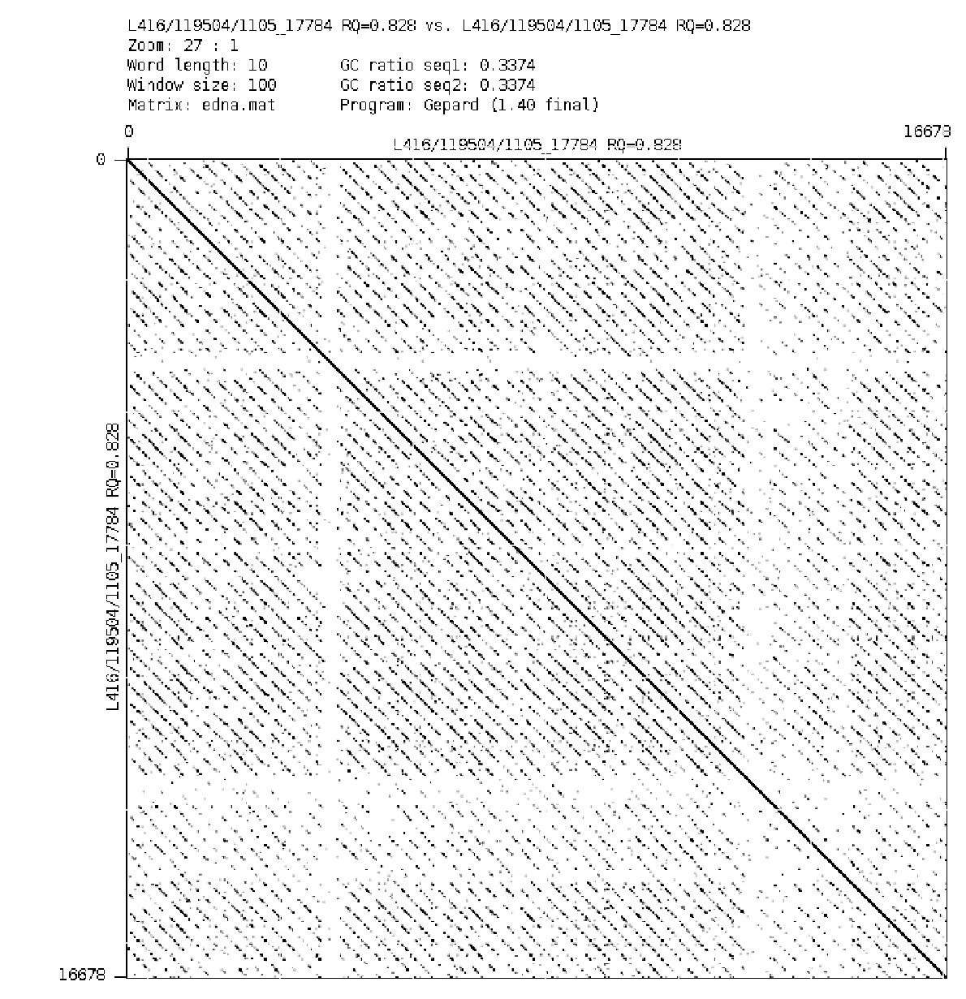

[(0, 3896, 359, 3529), (4251, 6927, 4621, 6563), (5951, 8969, 6976, 7941), (7998, 14267, 9866, 12272), (13950, 16679, 14349, 16302)]


In [175]:
visualize(8932)

-> due to low quality region?

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
1707,8167,L416/112185/115_9847 RQ=0.861,datander,5525,9732,380,NaN,NaN,NaN
1708,8167,L416/112185/115_9847 RQ=0.861,datander,3029,5516,349,NaN,NaN,NaN
1238,8167,L416/112185/115_9847 RQ=0.861,TRF,2678,9732,355,GTTTATTTCGGTAAAAAAGATCTGTATTTTCTCAAAAGCATTAAAA...,NaN,NaN
481,8167,L416/112185/115_9847 RQ=0.861,mTR,2680,9721,212,TTTGCCATTTTTTCGCAAATTTTAATGATGGTACCCCTTATCAAAA...,38.0,7041.0


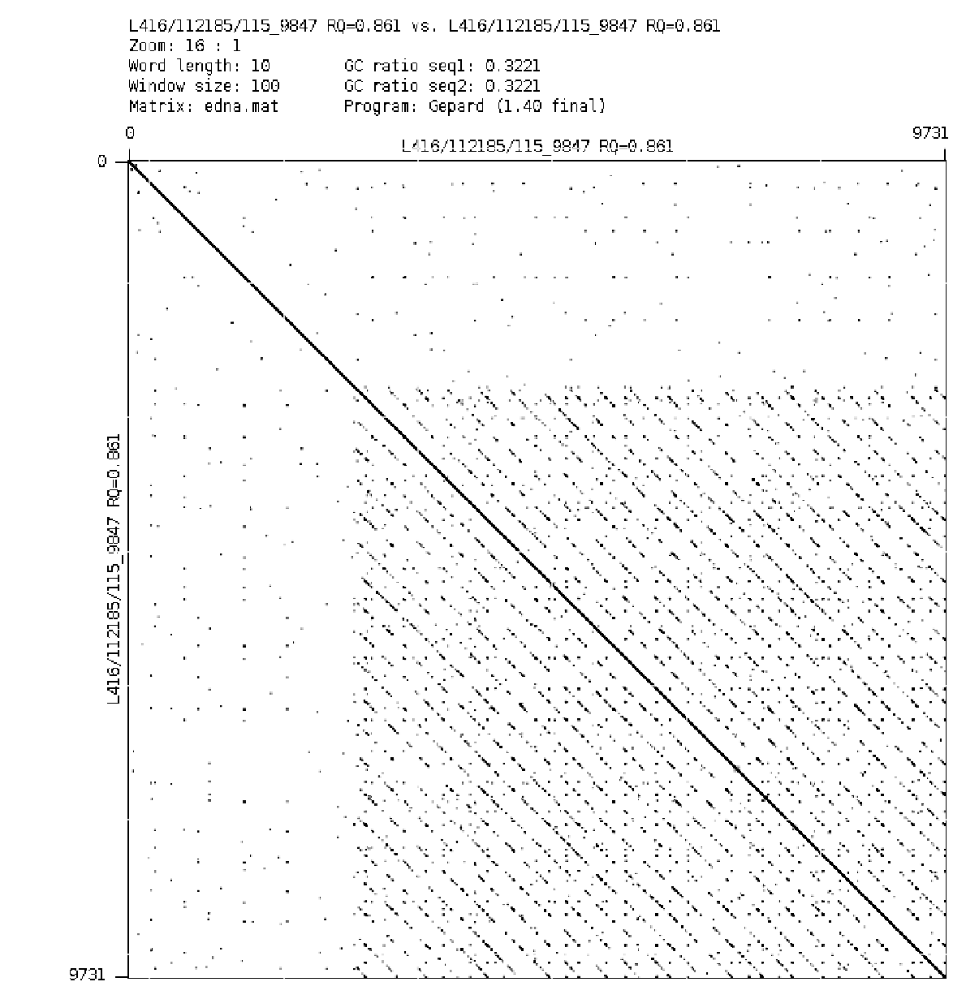

[(3029, 5516, 3378, 5158), (5525, 9732, 5905, 9354)]


In [176]:
visualize(8167)

-> split alignments due to deletion (of one unit?). this might be rather a desirable behavior

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
163,929,L416/22984/1562_18260 RQ=0.861,datander,9309,14247,2433,NaN,NaN,NaN
164,929,L416/22984/1562_18260 RQ=0.861,datander,4333,9327,2447,NaN,NaN,NaN
49,929,L416/22984/1562_18260 RQ=0.861,mTR,14165,14293,19,AATAAATATAACAATCAAA,6.0,117.0


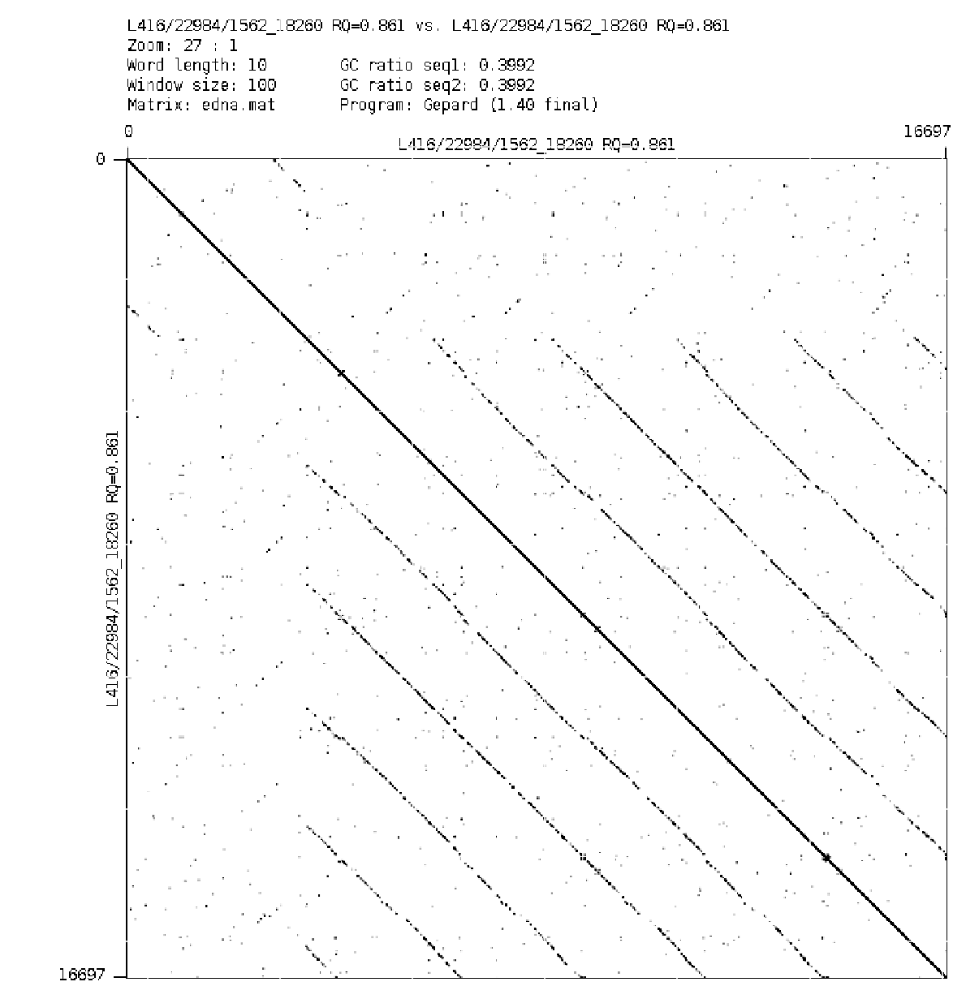

[(3885, 15059, 8845, 10121)]


In [177]:
visualize(929)

-> ABBABABBABABBA. rather desirable behavior?

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
278,1490,L416/31498/0_22166 RQ=0.866,datander,2730,12964,5116,NaN,NaN,NaN
279,1490,L416/31498/0_22166 RQ=0.866,datander,11733,19271,2088,NaN,NaN,NaN
229,1490,L416/31498/0_22166 RQ=0.866,TRF,5356,9116,1223,GGCTCCAAGCTTGCAATCTCCGATACAATGGCCAAGATGCAACCGT...,NaN,NaN


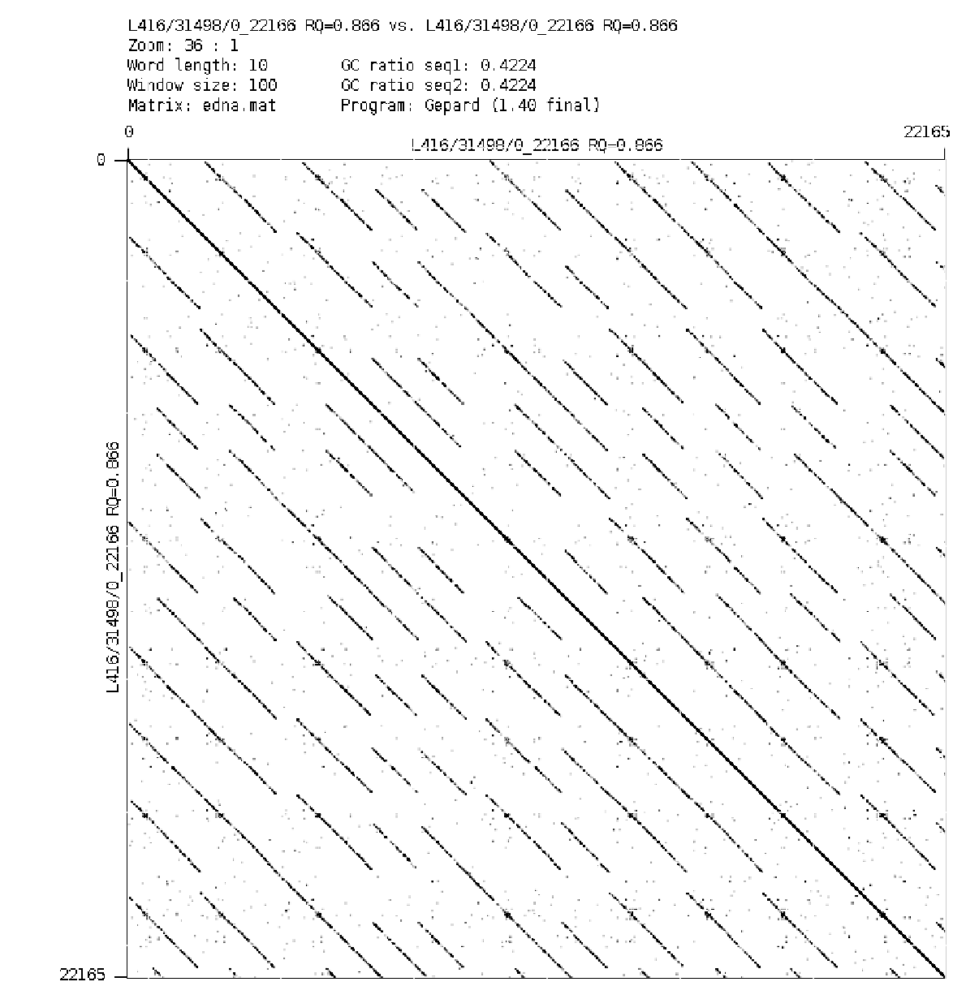

[(2730, 12964, 7846, 7843), (11733, 19271, 13821, 17175)]


In [178]:
visualize(1490)

-> difficult to judge whether this is desirable or not

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
1497,7291,L416/101882/0_24290 RQ=0.868,datander,21279,24290,1414,NaN,NaN,NaN
1498,7291,L416/101882/0_24290 RQ=0.868,datander,1184,6897,2030,NaN,NaN,NaN
1499,7291,L416/101882/0_24290 RQ=0.868,datander,15598,22707,1884,NaN,NaN,NaN
1500,7291,L416/101882/0_24290 RQ=0.868,datander,12515,16981,1409,NaN,NaN,NaN
1501,7291,L416/101882/0_24290 RQ=0.868,datander,6624,14194,1958,NaN,NaN,NaN
1502,7291,L416/101882/0_24290 RQ=0.868,datander,0,2899,1443,NaN,NaN,NaN
1108,7291,L416/101882/0_24290 RQ=0.868,TRF,13,2929,1432,TAAATTTTTCTAATAATACTAGTTCTGCTTTGATAACTAGAATTCG...,NaN,NaN
1109,7291,L416/101882/0_24290 RQ=0.868,TRF,4682,5485,290,ATTTTGTTTCATTATATGGTTAAACTTTTGAACTTTCAGACGTGAG...,NaN,NaN
1110,7291,L416/101882/0_24290 RQ=0.868,TRF,6628,14206,1916,ATAATAATAAAAATAACAGATTTTCCGAAAGAGAAAAATATTCATT...,NaN,NaN
1111,7291,L416/101882/0_24290 RQ=0.868,TRF,15597,22707,1863,TTTGTGATTGTGCTTAACTAAATTCTTCATAATAACTATGTCTGCT...,NaN,NaN


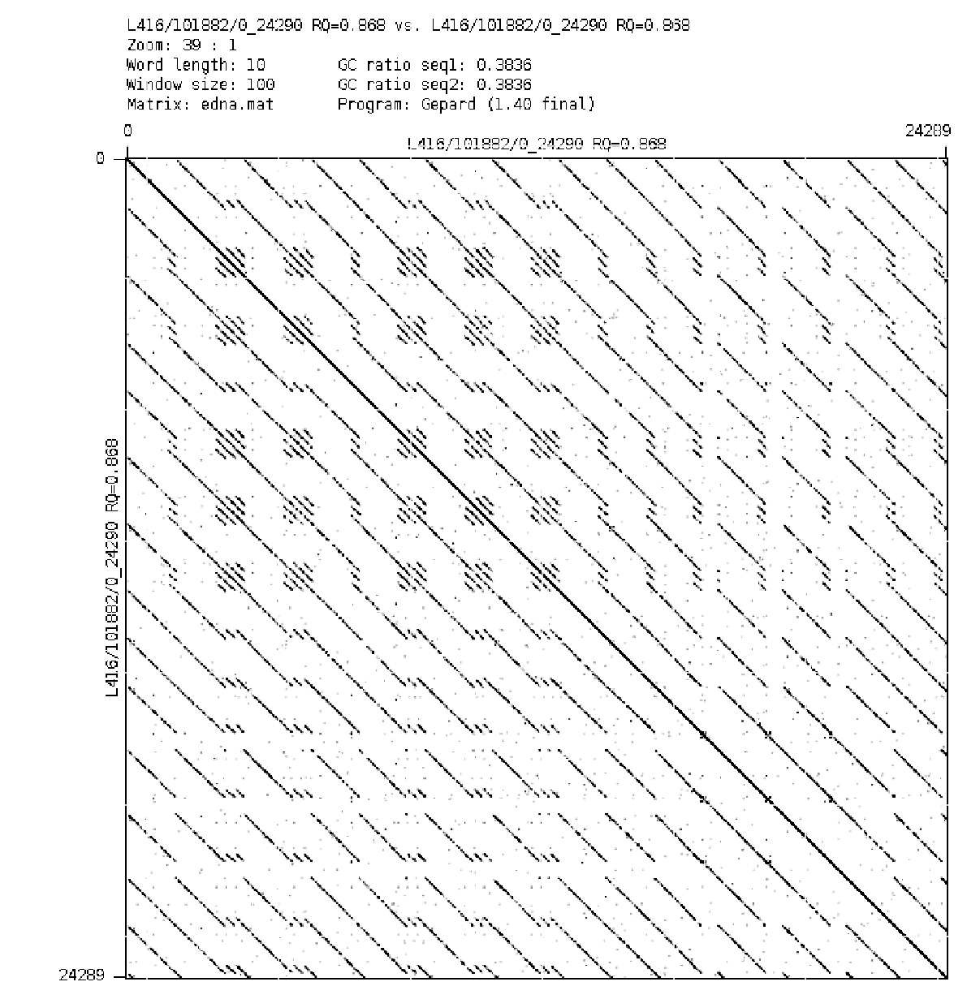

[(0, 2899, 1443, 1462), (1184, 6897, 3214, 4906), (6624, 14194, 8582, 12218), (12515, 16981, 13924, 15604), (15598, 22707, 17482, 20804), (21279, 24290, 22693, 22895)]


In [179]:
visualize(7291)

-> also difficult...

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
32261,157154,L443/22524/0_26282 RQ=0.868,datander,23482,25578,298,NaN,NaN,NaN
32262,157154,L443/22524/0_26282 RQ=0.868,datander,0,24805,11601,NaN,NaN,NaN
21856,157154,L443/22524/0_26282 RQ=0.868,TRF,2217,2997,251,TTTTCAATATGTATATGATTTAATTTACTCATAATAATTGCCAAAA...,NaN,NaN
21857,157154,L443/22524/0_26282 RQ=0.868,TRF,2877,3357,93,AAAATTCTTTAAAATTCTTTATATTAATTATATGATAGGGACAATA...,NaN,NaN
21858,157154,L443/22524/0_26282 RQ=0.868,TRF,11925,13795,245,AACATTTTTCACTTATACACATAATAAATATTAATTTTCATATGTA...,NaN,NaN
21859,157154,L443/22524/0_26282 RQ=0.868,TRF,13773,14462,243,TTTTCATATGTATATGATTTAATTTACTCATATAATTGCCAAAAAT...,NaN,NaN
21860,157154,L443/22524/0_26282 RQ=0.868,TRF,14511,14901,96,TAAATTCTTTATATTAATTATATGATAGGGACAATATCATAATGGC...,NaN,NaN
21861,157154,L443/22524/0_26282 RQ=0.868,TRF,23631,25578,493,TTCTCTATAATACTTAGAGAATATGGGAATATTTCAAACATTTTTC...,NaN,NaN
21862,157154,L443/22524/0_26282 RQ=0.868,TRF,25480,25797,97,TTTTCATATGTATATGAGTTTAATTTACTCATATAATTGCCAAAAT...,NaN,NaN


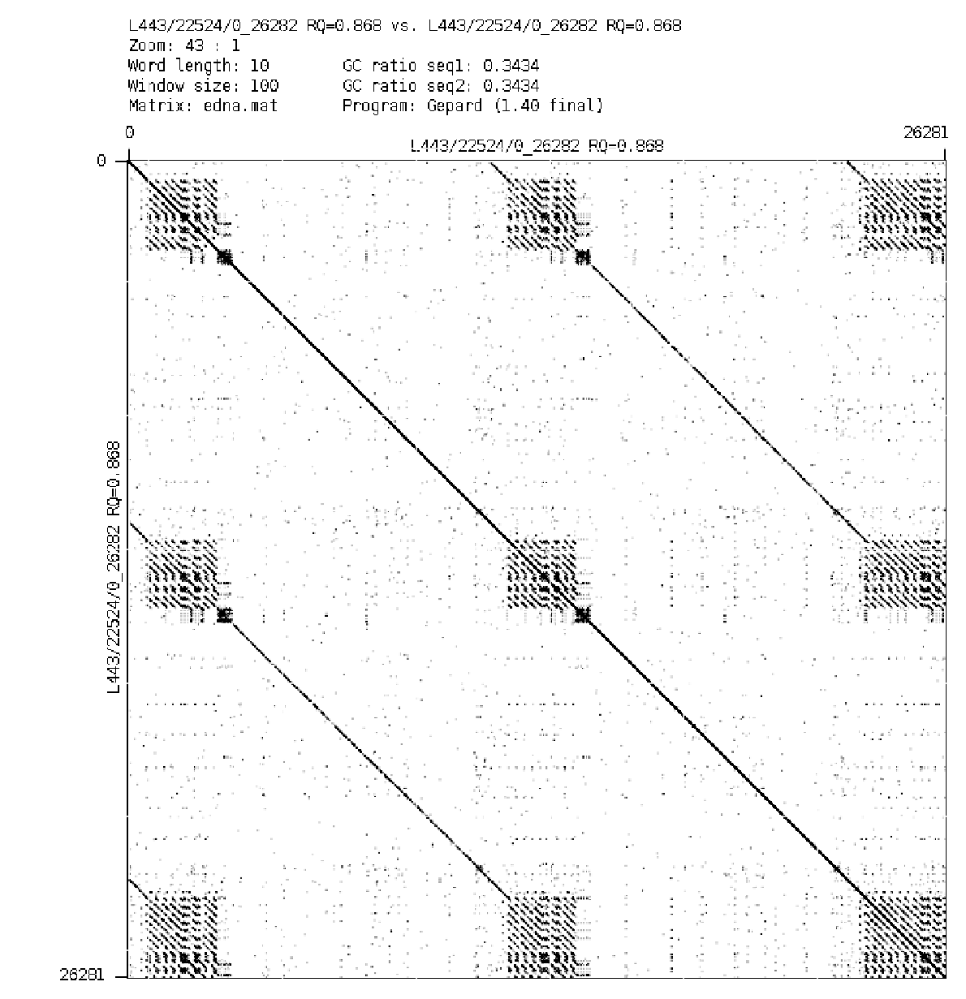

[(0, 24805, 11601, 13322), (23482, 25578, 23780, 25326)]


In [180]:
visualize(157154)

-> It seems that it is better to output both inner TRs and outer TRs (i.e. from all alignments in (not minimum) covering set)

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
66973,320085,L447/129046/0_24623 RQ=0.872,datander,9505,20802,3838,NaN,NaN,NaN
43598,320085,L447/129046/0_24623 RQ=0.872,TRF,11008,11365,97,TATCTTGTTTTTATTTGATTATGTTTATTTGTATTAATTCTTGTTT...,NaN,NaN


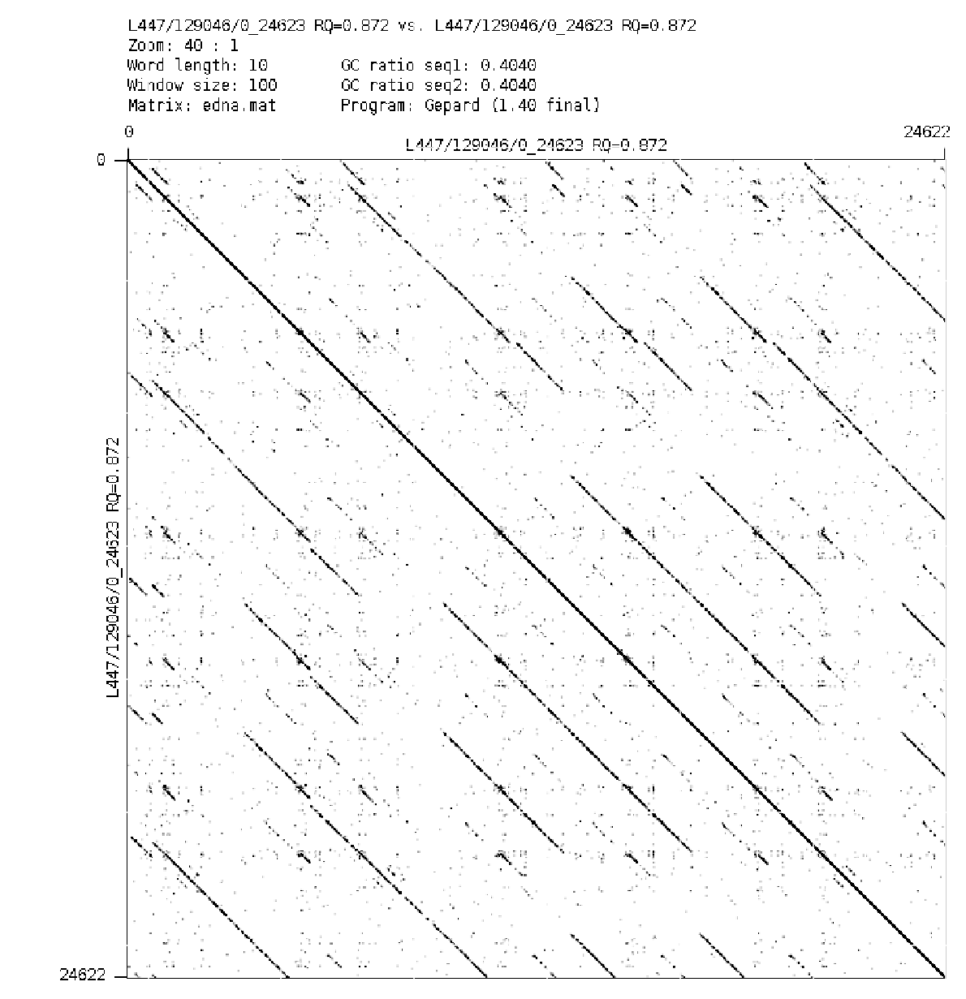

[(9505, 20802, 13343, 16962)]


In [181]:
visualize(320085)

## MAJOR FIX

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
85565,417700,L401/100337/4115_8093 RQ=0.859,datander,745,3978,350,NaN,NaN,NaN
55543,417700,L401/100337/4115_8093 RQ=0.859,TRF,108,3978,352,GCAGTTAATTACCATGTGCTAACGATCCCTATTACTTTTGGAAGGA...,NaN,NaN


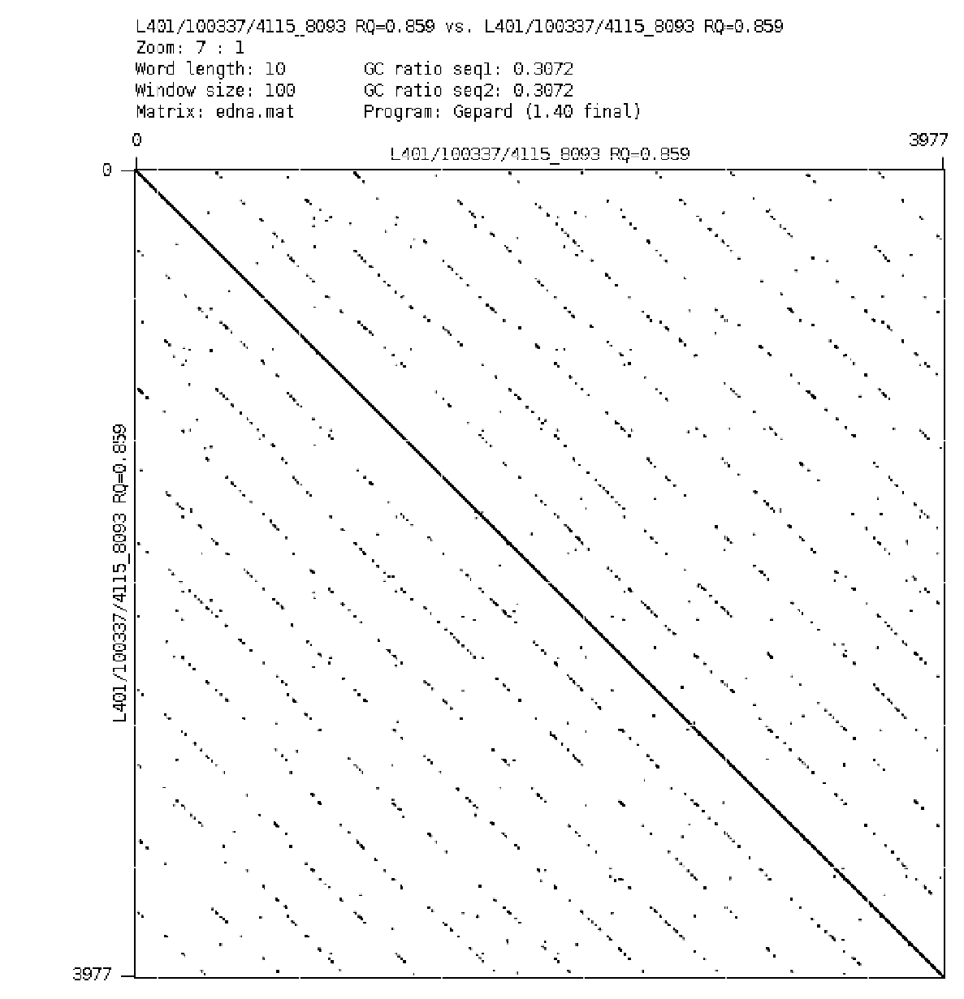

[(745, 3978, 1095, 3625)]


In [182]:
visualize(417700)

-> this would be misestimation by deletion and then missing alignment (at the borders this often happens?)

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
84856,413773,L401/88493/0_14934 RQ=0.868,datander,10127,12794,249,NaN,NaN,NaN
84857,413773,L401/88493/0_14934 RQ=0.868,datander,9358,10731,593,NaN,NaN,NaN
84858,413773,L401/88493/0_14934 RQ=0.868,datander,8248,9420,105,NaN,NaN,NaN
55096,413773,L401/88493/0_14934 RQ=0.868,TRF,8217,10011,93,TTAAAGAATTTTATCAAGAGTAGCCAAACACCTCGTCATCAATTTA...,NaN,NaN
55097,413773,L401/88493/0_14934 RQ=0.868,TRF,10110,11301,242,AAACTACTATAGGTAGGCAGTGGTTGCCGACGCTCCATATTGTTCA...,NaN,NaN
55098,413773,L401/88493/0_14934 RQ=0.868,TRF,11322,12811,241,TTTTAGTGAATGGATATAGTAGTGTAAGCTAGCTGTTTTACGACAG...,NaN,NaN


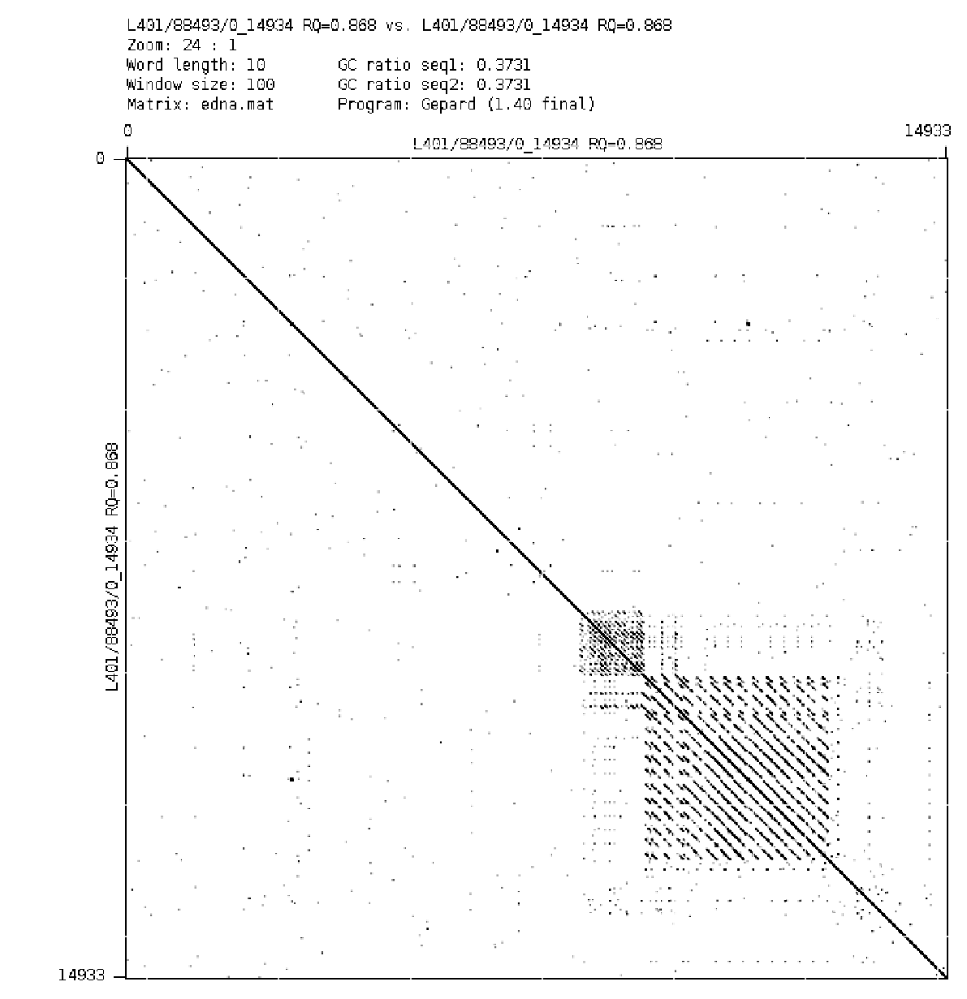

[(8248, 9420, 8353, 9324), (9358, 10731, 9951, 10126), (10127, 12794, 10376, 12529)]


In [183]:
visualize(413773)

-> same case as just above one. 

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
14071,69060,L441/27199/27487_38866 RQ=0.862,datander,5285,10930,384,NaN,NaN,NaN
14072,69060,L441/27199/27487_38866 RQ=0.862,datander,2188,5284,408,NaN,NaN,NaN
9892,69060,L441/27199/27487_38866 RQ=0.862,TRF,3005,10997,363,CCCCCCTCCTTCAAAAAAATGCGAAAATTGATCCAAAAATTAATTT...,NaN,NaN


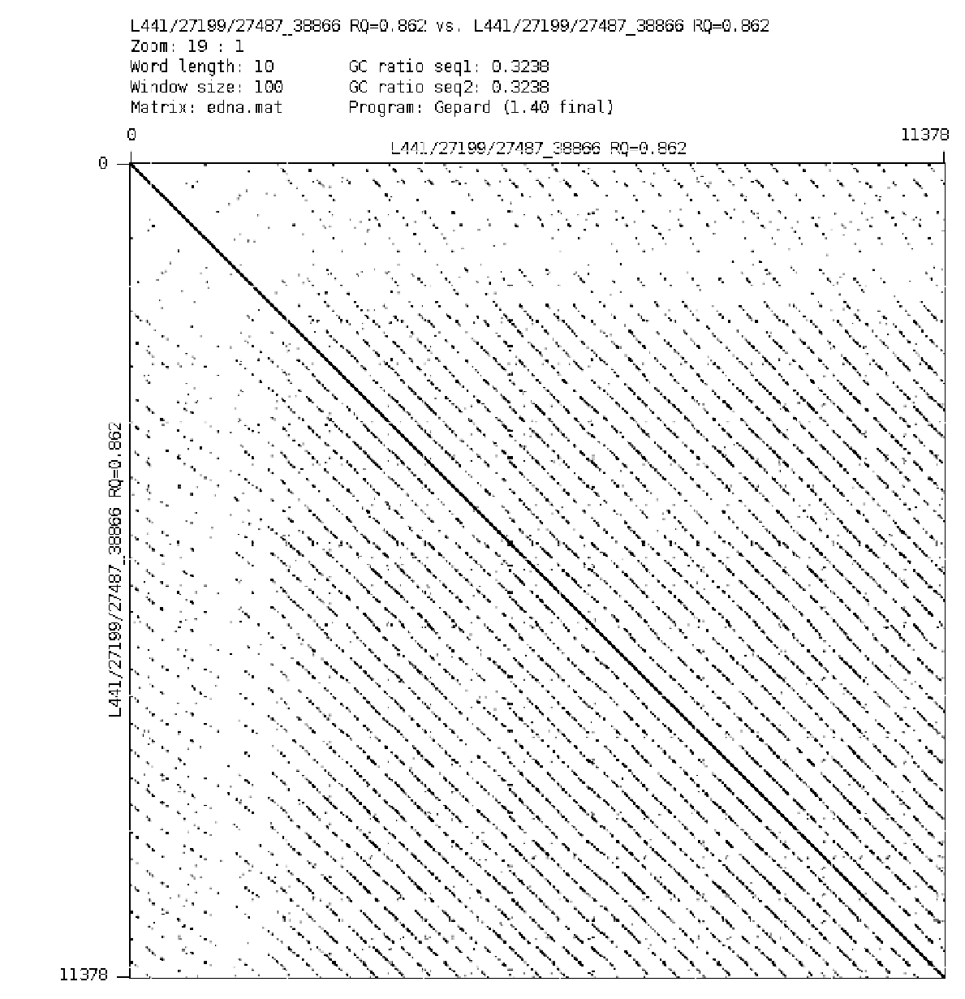

[(2188, 5284, 2596, 4879), (5285, 10930, 5669, 10554)]


In [184]:
visualize(69060)

-> this is bad...

### Short unit length

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
69968,334956,L400/29285/10192_13571 RQ=0.758,datander,2555,3379,20,NaN,NaN,NaN
45552,334956,L400/29285/10192_13571 RQ=0.758,TRF,2386,3378,159,TAATTATAATATAATATTATAATAAATAATATATAAATTATATTAT...,NaN,NaN


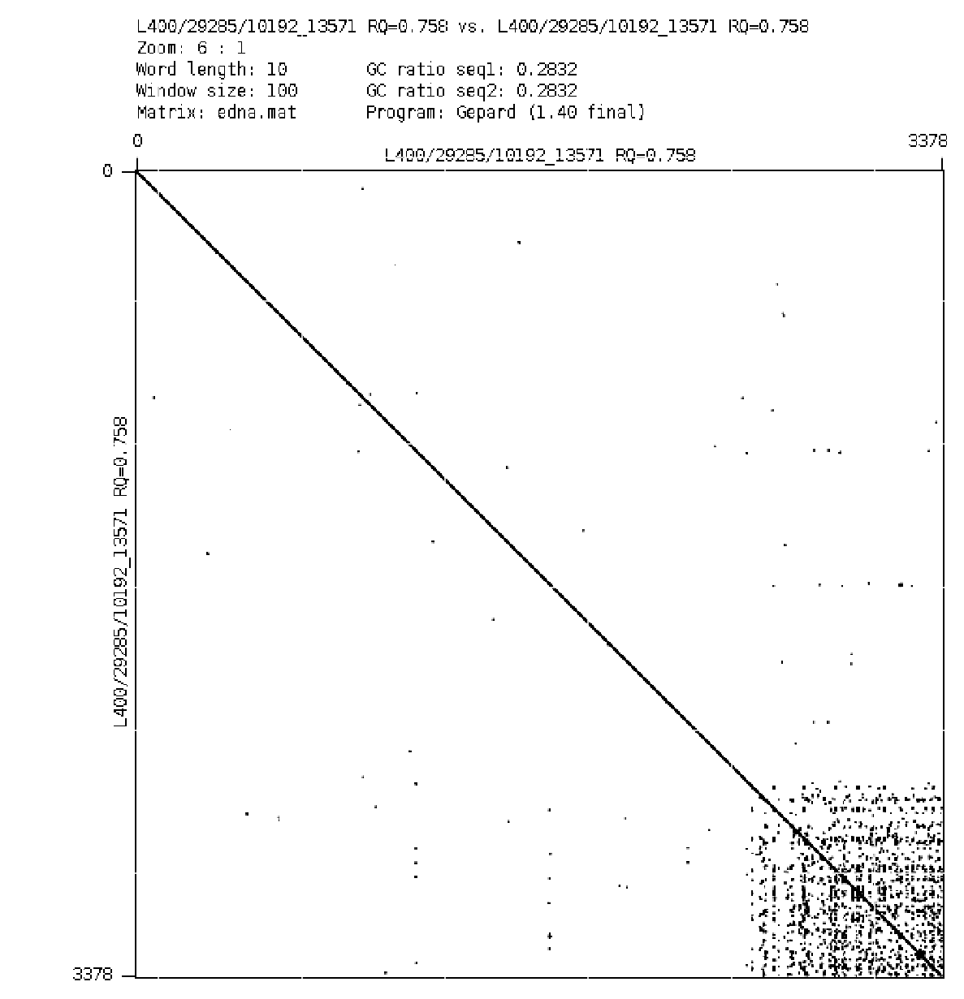

[(2555, 3379, 2575, 3377)]


In [185]:
visualize(334956)

-> strange dot plot and alignment plot

,dbid,header,method,start,end,unit length,unit sequence,# units,TR length
76903,371607,L400/120816/0_10500 RQ=0.842,datander,1651,2676,29,NaN,NaN,NaN
76904,371607,L400/120816/0_10500 RQ=0.842,datander,3139,4754,32,NaN,NaN,NaN
49913,371607,L400/120816/0_10500 RQ=0.842,TRF,3360,4806,149,CGAAATTATTTAGTTTTAAAAGGTGGCAAACGAAATTATTTATTTT...,NaN,NaN


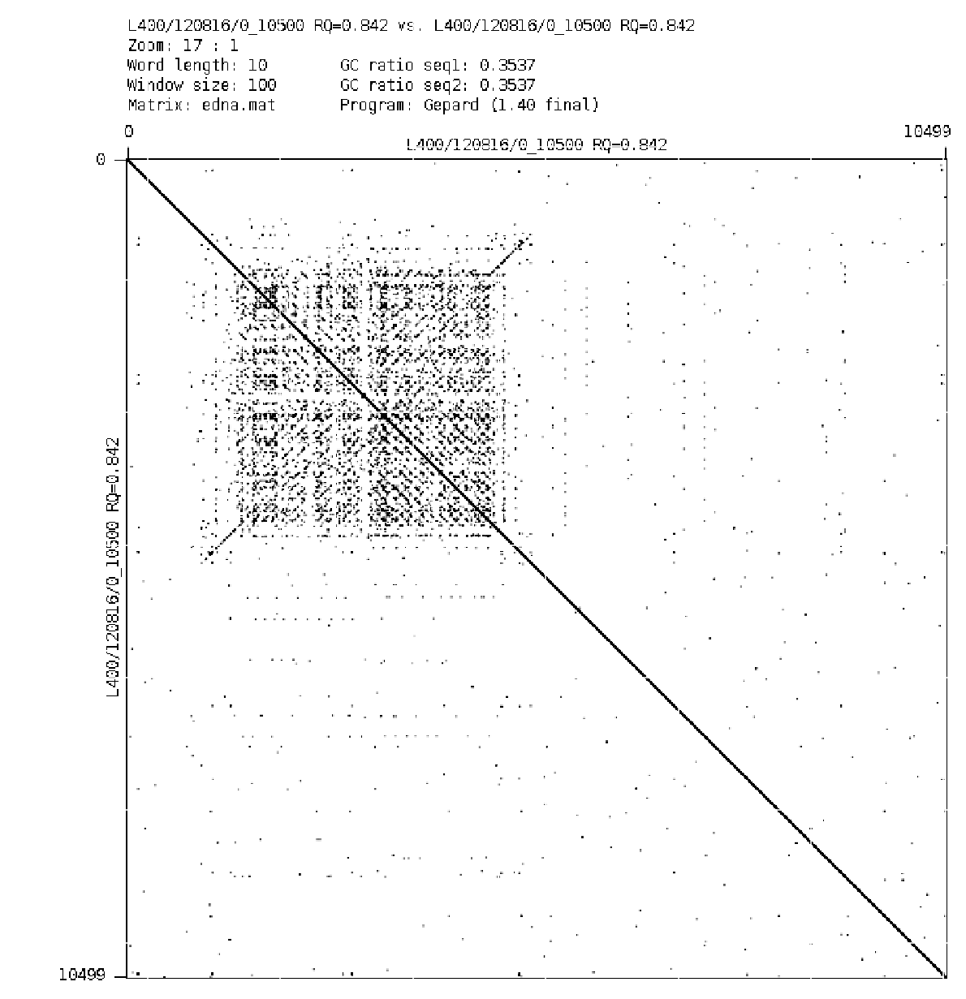

[(1365, 2066, 1464, 1977), (2049, 2995, 2174, 2871), (3139, 4754, 3171, 4686)]


In [186]:
visualize(371607)